# CMRM Assignment No. 2

In [74]:
import os
import librosa
import scipy
import sklearn 
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt
import IPython.display as ipd
from tqdm import tqdm 
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, recall_score, precision_score, confusion_matrix, ConfusionMatrixDisplay, roc_curve, roc_auc_score, precision_recall_curve, average_precision_score
from mutagen.easyid3 import EasyID3 

## Question 1

In [3]:
train_path = 'sonics/train'
test_path = 'sonics/test'

# -------------------------------------------------- #
# Train set
fake_path = os.path.join(train_path, 'fake')
real_path = os.path.join(train_path, 'real')

fake_train = []

for path_name in os.listdir(fake_path):

    if path_name.endswith('.mp3'):
        fake_train.append(path_name)

fake_train.sort()

# Print the number of files
print("Number of fake tracks in the train set:", len(fake_train))

real_train = []

for path_name in os.listdir(real_path):

    if path_name.endswith('.mp3'):
        real_train.append(path_name)

real_train.sort()

# Print the number of files
print("Number of real tracks in the train set:", len(real_train))


# -------------------------------------------------- #
# Test set

test_set = []

for path_name in os.listdir(test_path):

    if path_name.endswith('.mp3'):
        test_set.append(path_name)

test_set.sort()

# Print the number of files
print("Number of tracks in the test set:", len(test_set))

Number of fake tracks in the train set: 485
Number of real tracks in the train set: 485
Number of tracks in the test set: 515


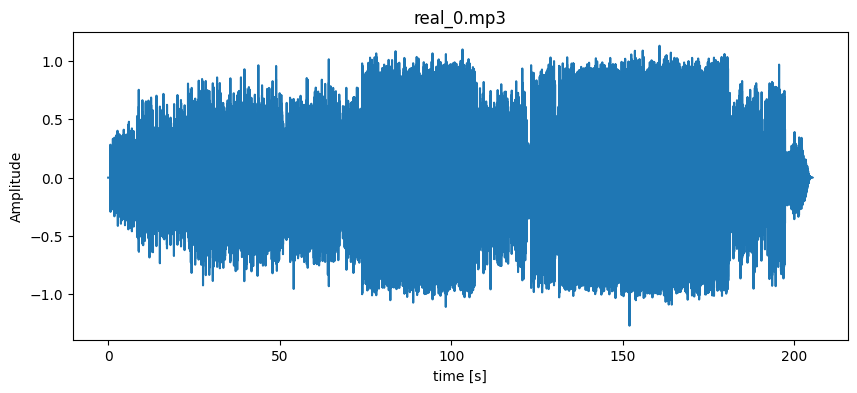

In [141]:
# Load signals
Fs = 22050

# f = fake_train[0][0]
# r = real_train[0][0]

f = librosa.load('sonics/train/fake/00089.mp3', sr=22050)[0]
r = librosa.load('sonics/train/real/real_00117.mp3', sr=22050)[0]

f_N = f.shape[0]
r_N = r.shape[0]

f_time_axis = np.arange(f_N) / Fs
r_time_axis = np.arange(r_N) / Fs

plt.figure(figsize=(10,4))
plt.plot(r_time_axis, r)
plt.title("real_0.mp3")
plt.xlabel("time [s]")
plt.ylabel("Amplitude")

ipd.Audio(r, rate=Fs)

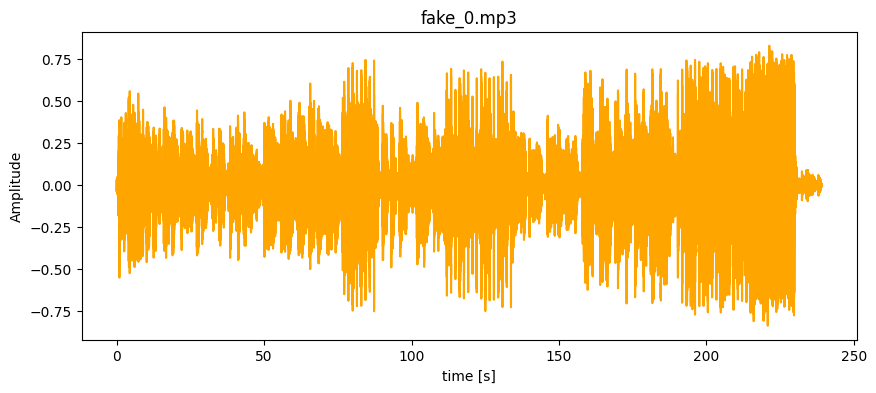

In [5]:
plt.figure(figsize=(10,4))
plt.plot(f_time_axis, f, color="orange")
plt.title("fake_0.mp3")
plt.xlabel("time [s]")
plt.ylabel("Amplitude")

ipd.Audio(f, rate=Fs)



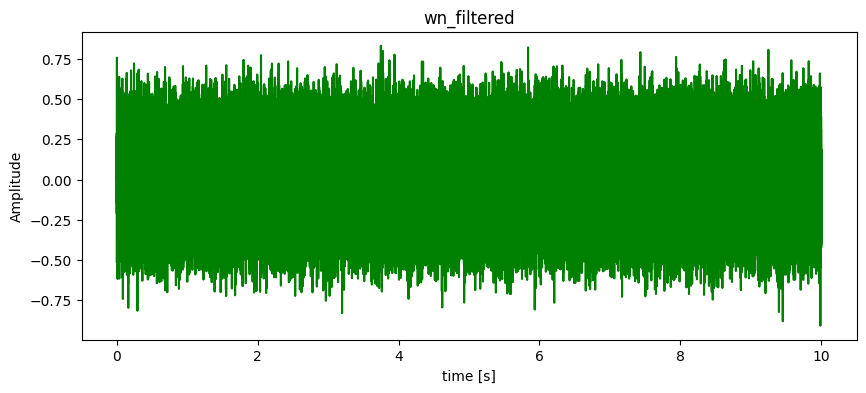

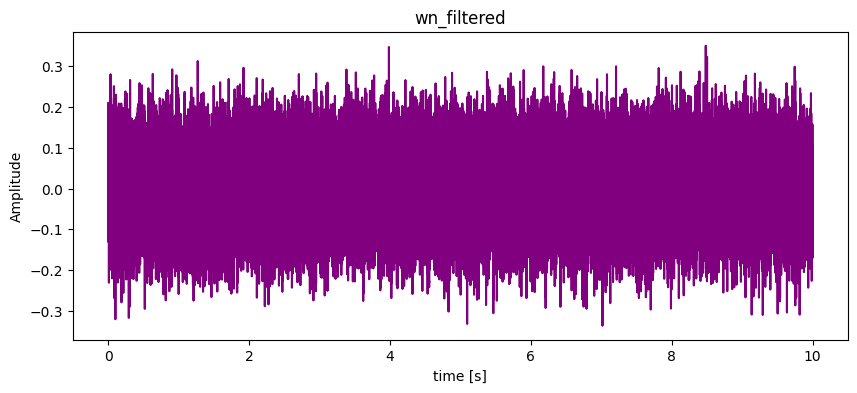

In [6]:
from scipy.signal import butter, filtfilt

wn = librosa.load('audiocheck.net_whitenoisegaussian.wav', sr=22050)[0]

wn_N = wn.shape[0]

wn_time_axis = np.arange(wn_N) / Fs


plt.figure(figsize=(10,4))
plt.plot(wn_time_axis, wn, color="green")
plt.title("wn_filtered")
plt.xlabel("time [s]")
plt.ylabel("Amplitude")

fs = 22050     
fc = 2000 

b, a = butter(N=2, Wn=fc/(fs/2), btype='low')


wn_filtered = filtfilt(b, a, wn)

#wn_filtered = wn_filtered * (10 ** (-90 / 10))

wn_filt_N = wn_filtered.shape[0]

wn_filt_time_axis = np.arange(wn_filt_N) / Fs

plt.figure(figsize=(10,4))
plt.plot(wn_time_axis, wn_filtered, color="purple")
plt.title("wn_filtered")
plt.xlabel("time [s]")
plt.ylabel("Amplitude")

ipd.Audio(wn_filtered, rate=Fs)


Text(0.5, 1.0, 'FFT fake')

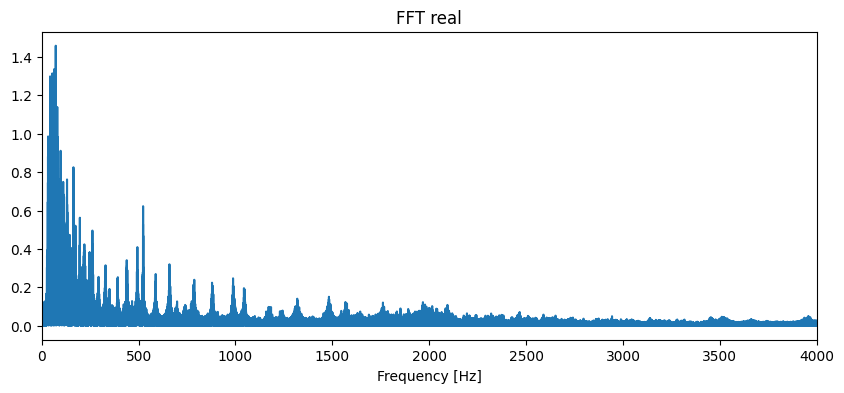

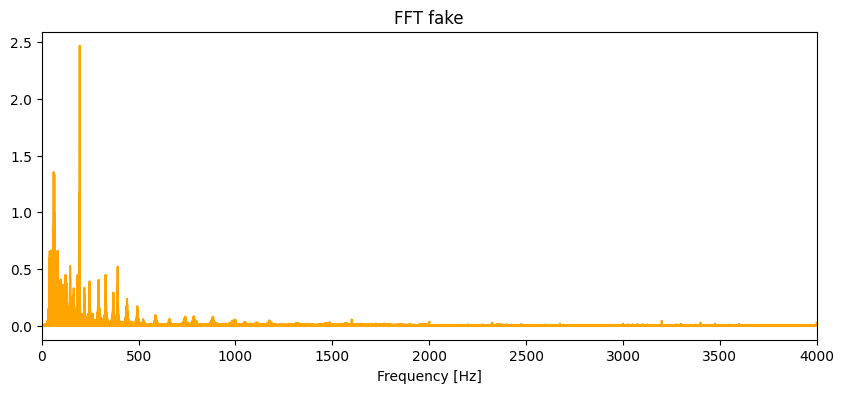

In [7]:
# FFT
R = np.abs(np.fft.fft(r)) /Fs #magnitude
r_freq_axis = np.fft.fftfreq(r_N, d=1/Fs)
R = R[:r_N//2]
r_freq_axis = r_freq_axis[:r_N//2]

plt.figure(figsize=(10,4))
plt.plot(r_freq_axis, R)
plt.xlim((0, 4000))
plt.xlabel("Frequency [Hz]")
plt.title("FFT real")


F = np.abs(np.fft.fft(f)) /Fs #magnitude
f_freq_axis = np.fft.fftfreq(f_N, d=1/Fs)
F = F[:f_N//2]
f_freq_axis = f_freq_axis[:f_N//2]

plt.figure(figsize=(10,4))
plt.plot(f_freq_axis, F, color="orange")
plt.xlim((0, 4000))
plt.xlabel("Frequency [Hz]")
plt.title("FFT fake")


In [142]:
def STFT(x, w, H, fn):

    N = len(w)
    L = len(x)
    M = int(np.floor(L-N) / H)
    X = np.zeros((N, M + 1), dtype='complex')

    for m in range(M + 1):
        x_win = x[m * H: m * H + N] * w
        X_win = np.fft.fft(x_win)
        X[:, m] = X_win

    #K = (N // 2) +1
    K = (N+1) // 2
    X = X[:K, :]

    X = np.abs(X) ** 2

    eps = np.finfo(float).eps

    X_dB = 10 * np.log10(X + eps)

    print(type(X))
    print(X.shape)


    #plot parameters
    x_time_axis = np.arange(X_dB.shape[1]) * H / Fs
    x_frequency_axis = np.arange(X_dB.shape[0]) * Fs / N

    left = min(x_time_axis)
    right = max(x_time_axis) + N / Fs
    lower = min(x_frequency_axis)
    upper = max(x_frequency_axis)


    #plot
    plt.figure(figsize=(10,4))
    img = plt.imshow(X_dB, origin='lower', aspect='auto', extent=[left, right, lower, upper], vmin = -20, vmax=30)
    plt.colorbar(img)
    plt.xlabel('Time (seconds)')
    plt.ylabel('Frequency (Hz)')
    plt.title(f'STFT {fn}')
    plt.tight_layout()

    return X, X_dB

<class 'numpy.ndarray'>
(2048, 4420)
<class 'numpy.ndarray'>
(2048, 5143)
<class 'numpy.ndarray'>
(2048, 212)


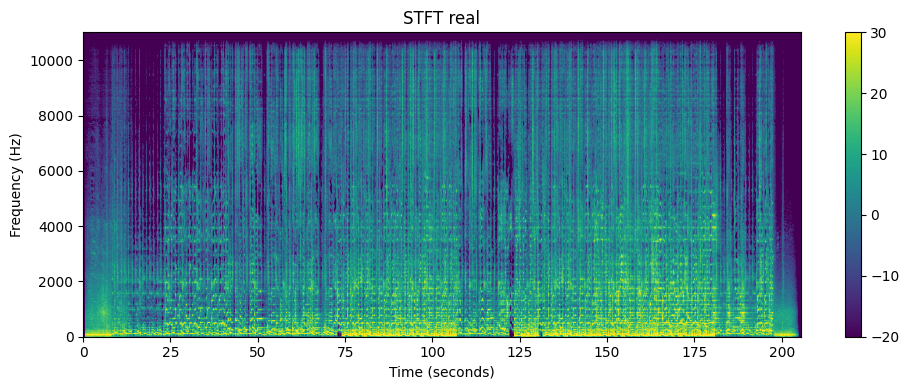

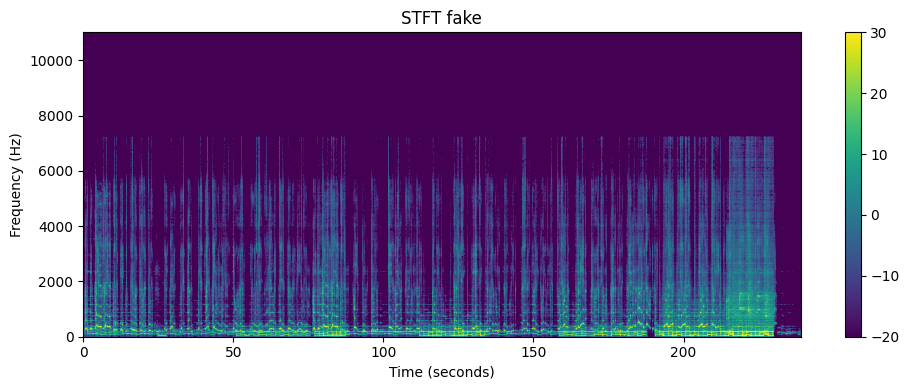

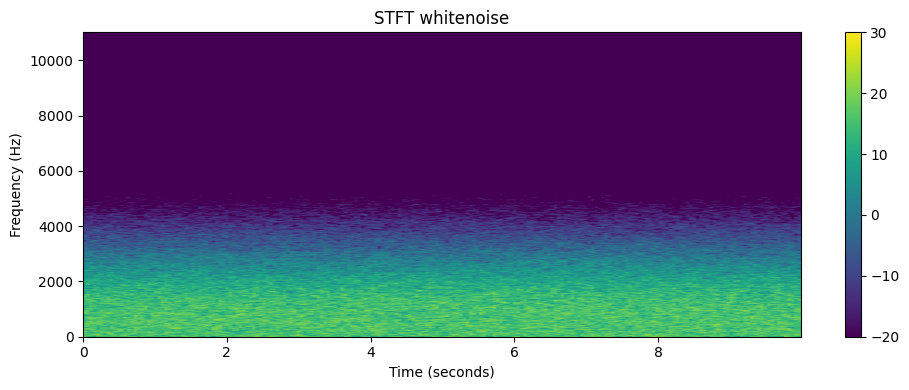

In [143]:
#STFT

#user parameters
N = 4096
H = 1024 # H < N --> Overlapping 75% --> Good Time Resolution in a single

w = np.hanning(N)

R_stft, R_stft_dB = STFT(r, w, H, fn='real')
F_stft, F_stft_dB = STFT(f, w, H, fn='fake')

wn_stft, wn_stft_dB = STFT(wn_filtered, w, H, fn='whitenoise')


## Question 2

In [10]:
from utils import lower_envelope, max_normalise, curve_profile

def fakeprint(stft, f_range = [0, 16000], fs = 22050):
    """
    Compute the fakeprint feature from an STFT representation.

        Args:
            stft: 2D STFT spectrogram.
            f_range: Frequency range [min_freq, max_freq] over which the
                     curve profile is computed.
            SR: Sampling rate of the original audio signal.

        Returns:
            fp_curve: Normalized fakeprint feature curve extracted from the
                      averaged spectral profile.
    """

    #first task: reduce the stft matrix to a single spectral curve. 
    #you do this by computing the mean of the STFT across all time frames
    
    bins = stft.shape[0]
    mean_spectrum = np.zeros(bins)
    
    x_freq_in = np.linspace(0, fs/2, bins)
    mean_spectrum = np.mean(stft, axis=1)

    x_freq_out , x_curve = curve_profile(x_freq_in, mean_spectrum, f_range)

    fp_curve = max_normalise(x_curve) #max_dB = 5 dB

    return fp_curve, x_freq_out

(5.385930630190523, 11025.0)

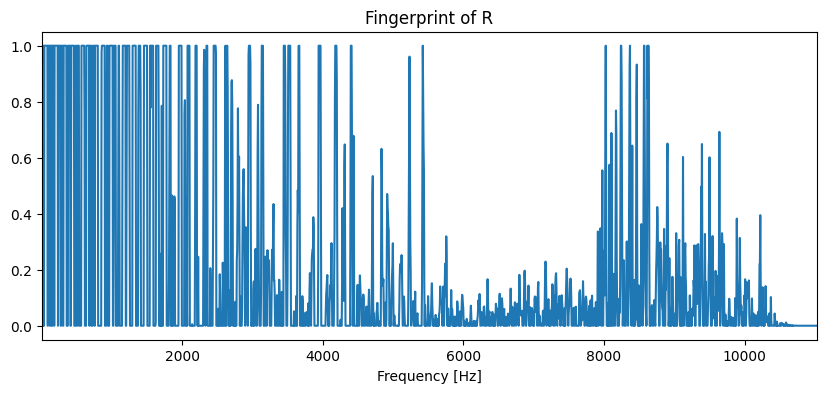

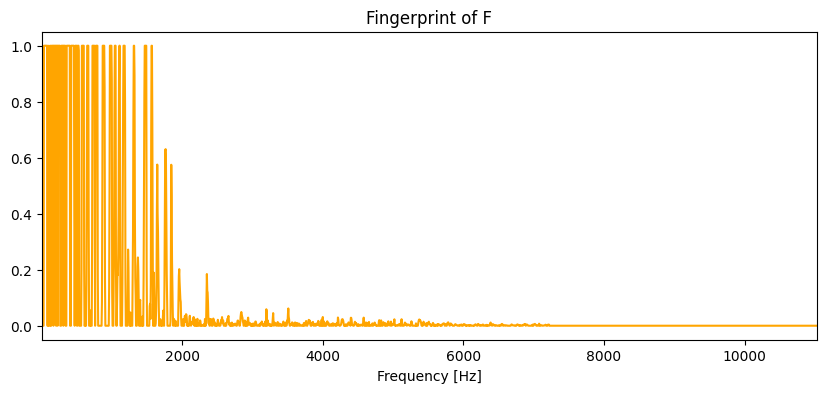

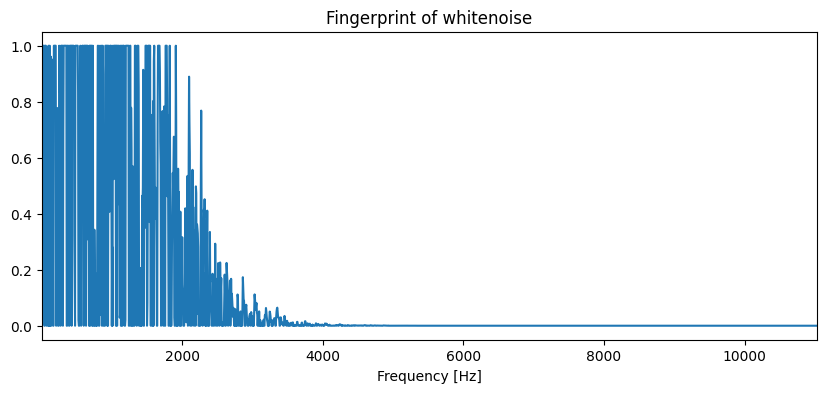

In [11]:
# Test fakeprint

fp_curve_f, x_freq = fakeprint(F_stft)

fp_curve_r, x_freq = fakeprint(R_stft)

fp_curve_wn, x_freq = fakeprint(wn_stft)

plt.figure(figsize=(10,4))
plt.plot(x_freq, fp_curve_r)
plt.title("Fingerprint of R")
plt.xlabel("Frequency [Hz]")
plt.xlim((x_freq[0], x_freq[-1]))

plt.figure(figsize=(10,4))
plt.plot(x_freq, fp_curve_f, color='orange')
plt.title("Fingerprint of F")
plt.xlabel("Frequency [Hz]")
plt.xlim((x_freq[0], x_freq[-1]))

plt.figure(figsize=(10,4))
plt.plot(x_freq, fp_curve_wn)
plt.title("Fingerprint of whitenoise")
plt.xlabel("Frequency [Hz]")
plt.xlim((x_freq[0], x_freq[-1]))

## Question 3

In [12]:
def compute_feature_vector(filename, Fs, N=4096, H=1024):
    """Compute the feature vector 

    Args:
        filename: Input filename
        Fs: Sampling rate
        N: Window length
        H: Hop size

    Returns:
        f_vector: Feature vector
    """

    f, sr = librosa.load(filename, mono = True, sr = Fs)
    
    F = librosa.stft(f, n_fft=N, hop_length=H, win_length=N, window='hann')

    f_vector, x_freq = fakeprint(F, f_range = [0, 16000], fs = Fs)

    return f_vector, x_freq

/opt/miniconda3/envs/workspace1/lib/python3.8/site-packages/matplotlib/cbook/__init__.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


Text(0.5, 1.0, 'Fingerprint')

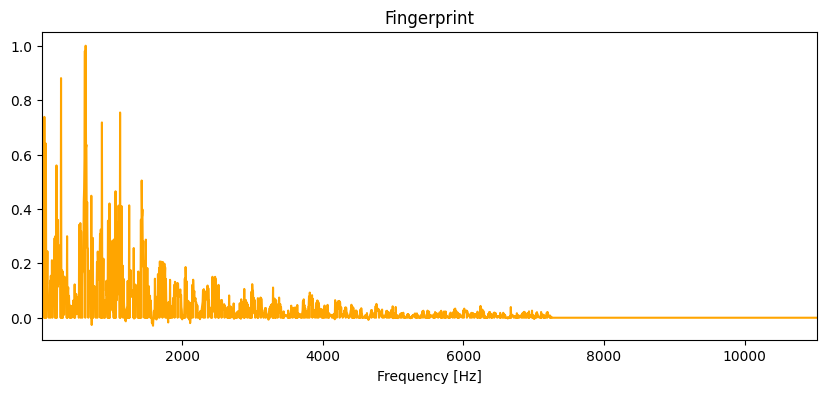

In [13]:
# test compute_feature_vector

Fs = 22050 
filename = os.path.join('sonics/train/fake', fake_train[0])
f_vector, x_freq = compute_feature_vector(filename, Fs)

plt.figure(figsize=(10,4))
plt.plot(x_freq, f_vector, color = 'orange')
plt.xlabel("Frequency [Hz]")
plt.xlim((x_freq[0], x_freq[-1]))
plt.title("Fingerprint")

In [14]:
# Define labels_dict
labels_dict = {0 : 'fake', 1: 'real'}

# Define labels list
labels = []

# Compute feature vector - train
train_fvector = []

for f in tqdm(fake_train, desc = "Processing fake_train"):
    filename = os.path.join('sonics/train/fake', f)
    f_vector, _ = compute_feature_vector(filename, Fs)
    train_fvector.append(f_vector)
    labels.append(0)

for r in tqdm(real_train, desc = "Processing real_train"):
    filename = os.path.join('sonics/train/real', r)
    f_vector, _ = compute_feature_vector(filename, Fs)
    train_fvector.append(f_vector)
    labels.append(1)

# Compute feature vector - test
test_fvector = []

for t in tqdm(test_set, desc = "Processing test_set"):
    filename = os.path.join('sonics/test', t)
    f_vector, _ = compute_feature_vector(filename, Fs)
    test_fvector.append(f_vector)


Processing test_set: 100%|██████████| 515/515 [00:59<00:00,  8.70it/s]


In [15]:
print(f"train_fvector is a list of {np.array(train_fvector).shape[0]} elements, each element is an array of dimension {np.array(train_fvector).shape[1]} (bins in the considered frequency range)")
print(f"test_fvector is a list of {np.array(test_fvector).shape[0]} elements, each element is an array of dmension {np.array(test_fvector).shape[1]} (bins in the considered frequency range)")


train_fvector is a list of 970 elements, each element is an array of dimension 2048 (bins in the considered frequency range)
test_fvector is a list of 515 elements, each element is an array of dmension 2048 (bins in the considered frequency range)


In [16]:
# Train regressor
model = LogisticRegression(class_weight="balanced")

x_train = np.abs(train_fvector)
y_train = labels
model.fit(x_train, y_train)
y_pred_train = model.predict(x_train)

Train accuracy: 0.98659793814433


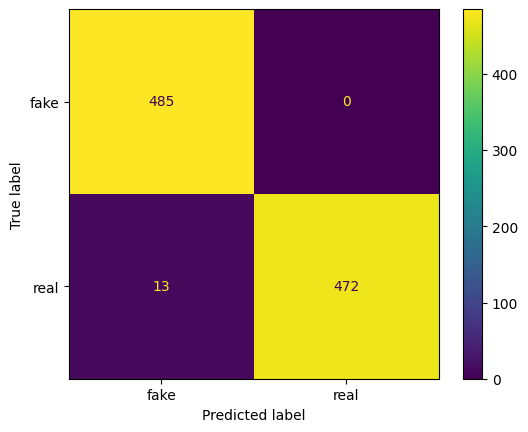

In [17]:
# Print the accuracy for the train set
print("Train accuracy:", accuracy_score(y_train, y_pred_train))

# Plot the confusion matrix
cm = confusion_matrix(y_train, y_pred_train)
disp = ConfusionMatrixDisplay(cm, display_labels=['fake','real'])
disp.plot()

## Question 4

In [18]:
# Compute prediction for the test set
x_test = np.abs(test_fvector)

y_pred_test = model.predict(x_test)

# Print tracks classified as 'real'
real_tracks = []

for i in range(len(test_set)):
    filename = test_set[i]
    if y_pred_test[i] == 1: real_tracks.append(filename)

print('The real tracks are: \n')

for i in real_tracks:
    print(f'{i} \n')


The real tracks are: 

35394.mp3 

42833.mp3 

45139.mp3 

53966.mp3 

54100.mp3 

54273.mp3 



In [ ]:
# Find all the ['date'] metadata analyzing test_set
psw = 0

gt_real = []

for filename in test_set:
    try:
        path = os.path.join('sonics/test', filename)
        md = EasyID3(path)['date']
        print(f'{filename}: {md}')
        psw = psw + int(md[0])
        gt_real.append(filename)
    except: 
        print(f'{filename} has no [date] field')

print(f'The password is: {psw}') 

    

27679.mp3 has no [date] field
27744.mp3 has no [date] field
27839.mp3 has no [date] field
27841.mp3 has no [date] field
27904.mp3 has no [date] field
27908.mp3 has no [date] field
27913.mp3 has no [date] field
27937.mp3 has no [date] field
27984.mp3 has no [date] field
28009.mp3 has no [date] field
28028.mp3 has no [date] field
28097.mp3 has no [date] field
28108.mp3 has no [date] field
28118.mp3 has no [date] field
28147.mp3 has no [date] field
28151.mp3 has no [date] field
28217.mp3 has no [date] field
28229.mp3 has no [date] field
28267.mp3 has no [date] field
28291.mp3 has no [date] field
28293.mp3 has no [date] field
28297.mp3 has no [date] field
28322.mp3 has no [date] field
28349.mp3 has no [date] field
28360.mp3 has no [date] field
28477.mp3 has no [date] field
28677.mp3 has no [date] field
28689.mp3 has no [date] field
28822.mp3 has no [date] field
28823.mp3 has no [date] field
28905.mp3 has no [date] field
29016.mp3 has no [date] field
29020.mp3 has no [date] field
29043.mp3 

In [31]:
# Find password
psw = 0

for filename in real_tracks:
    try:
        path = os.path.join('sonics/test', filename)
        md = EasyID3(path)['date']
        print(f'{filename}: {md}')
        psw = psw + int(md[0])
    except: 
        print(f'{filename} has no [date] field')

print(f'The password is: {psw}')

35394.mp3 has no [date] field
42833.mp3 has no [date] field
45139.mp3 has no [date] field
53966.mp3: ['0476']
54100.mp3: ['1492']
54273.mp3 has no [date] field
The password is: 1968


In [32]:
# Verify if your items are real

fake_labels = ['mostly fake', 'half fake', 'full fake']

gt = pd.read_csv('sonics/ground_truth.csv')

r, c = gt.shape

print(f'ground truth .csv has {r} rows and {c} columns')

columns_names = list(gt.columns)

print('\nColumns Names:')
for i in columns_names:
    print(f'\n{i}\n')

# Create gt label list

ground_truth = []

for filename in test_set:
    label = gt.loc[gt['id'] == int(filename.split('.')[0]) , 'label'].iloc[0]
    if label == 'real':
        ground_truth.append(1)
    elif label in fake_labels:
        ground_truth.append(0)


ground truth .csv has 24733 rows and 17 columns

Columns Names:

id


lyrics


algorithm


style


filename


bit_rate


duration


source


lyrics_feature


topic


genre


mood


label


target


skip_time


no_vocal


split



In [33]:
gt[gt['label'] == 'real'].head()

,id,lyrics,algorithm,style,filename,bit_rate,duration,source,lyrics_feature,topic,genre,mood,label,target,skip_time,no_vocal,split
24729,51890,I'm dreaming of a white Christmas ...,NaN,"pop, full song, christmas",5198,NaN,NaN,NaN,Merry Christmas,christmas,pop,christmas,real,NaN,NaN,True,test
24730,52180,Have a holly jolly Christmas It's the best tim...,NaN,"pop, full song, christmas",51280,NaN,NaN,NaN,and a happy new year,christmas,pop,christmas,real,NaN,NaN,True,test
24731,53966,"Have yourself a merry little Christmas, Let yo...",NaN,"pop, full song, christmas",53966,NaN,NaN,NaN,to you and,christmas,pop,christmas,real,NaN,NaN,True,test
24732,54100,I'll have a blue Christmas without you I'll be...,NaN,"pop, full song, christmas",54100,NaN,NaN,NaN,your family,christmas,pop,christmas,real,NaN,NaN,True,test


In [34]:
gt[gt['label'].isin(fake_labels)].head()

,id,lyrics,algorithm,style,filename,bit_rate,duration,source,lyrics_feature,topic,genre,mood,label,target,skip_time,no_vocal,split
0,54113,"[Intro]\n(Whoah)\nStaring at the stars, lost i...",chirp-v3.5,"male vocals, lounge, piano, saxophone, slow te...",fake_54113_suno_0,34956.0,239.076,suno,* subject_matter: “The song reflects on the jo...,star trek (TV),lounge,mournful,full fake,1.0,5.684094,False,train
1,53851,"[Intro]\n(Whisper) Athena, goddess of the nigh...",chirp-v3.5,"female vocals, salsa, piano, trumpet, percussi...",fake_53851_suno_0,37343.0,207.360,suno,* subject_matter: “The song tells the story of...,athena (myth),salsa,tense,full fake,1.0,6.865344,False,test
2,53853,"[Verse 1]\nStaring at the mirror, don't recogn...",chirp-v3,"male vocals, guitar, drums, bass, grunge, mode...",fake_53853_suno_0,36865.0,120.096,suno,* subject_matter: “The song is about a person'...,overcoming adversity,grunge,introspective,full fake,1.0,0.030969,False,test
3,53854,"[Intro]\nIn the shadows of the night, where da...",chirp-v3.5,"male vocals, electric guitar, drums, bass, pia...",fake_53854_suno_0,35614.0,240.084,suno,"* subject_matter: ""The song is about Dracula, ...",dracula (literature),christian rock,motivated,full fake,1.0,0.250344,False,test
4,53855,"[Verse 1]\nIn a darkened room, I sit alone,\nG...",chirp-v2-xxl-alpha,"male vocals, grunge, guitar, bass, drums, slow...",fake_53855_suno_0,38180.0,80.100,suno,* subject_matter: “The song delves into the li...,isaac newton (scientist),grunge,gloomy,full fake,1.0,8.519094,False,test


In [35]:
for filename in real_tracks:
    label = gt.loc[gt['id'] == int(filename.split('.')[0]) , 'label'].iloc[0]
    print(f'\n{filename}: {label}\n')


35394.mp3: mostly fake


42833.mp3: mostly fake


45139.mp3: mostly fake


53966.mp3: real


54100.mp3: real


54273.mp3: full fake



Test accuracy: 0.9883495145631068


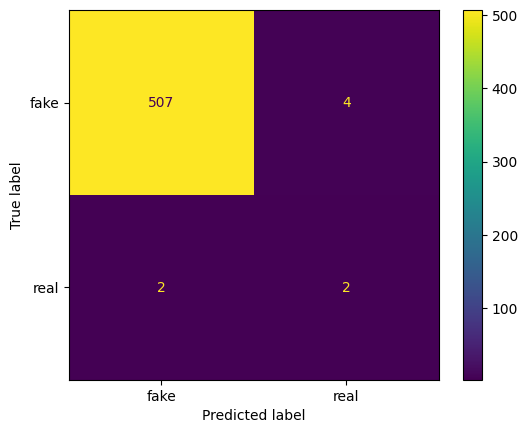

In [104]:
# Print the accuracy for the test set

y_test = ground_truth

print("Test accuracy:", accuracy_score(y_test, y_pred_test))

# Plot the confusion matrix
cm = confusion_matrix(y_test, y_pred_test)
disp = ConfusionMatrixDisplay(cm, display_labels=['fake','real'])
disp.plot()
# Plot the confusion matrix

In [129]:
# Probability Matrix and threshold changing

predicted_probabilities = model.predict_proba(x_test) # returns a probability matrix: rows --> samples; col --> classes (Real/Fake)

pp = pd.DataFrame(predicted_probabilities, columns=["Fake", "Real"])

#print(pp.to_string(index=False))

print('\nTracks predicted as real [p(real)>0.5; p(fake)<0.5]:')
real = pp['Real']
fake = pp['Fake']
for i in range(len(test_set)):
    if (real[i] > 0.5)  & (fake[i] < 0.5) : print(f'{test_set[i]} --> p(real): {real[i]}; p(fake): {fake[i]}')

threshold = 0.7
real_tracks_2 = []
y_pred_test_2 = (predicted_probabilities[:, 1] >= threshold).astype(int)

for i in range(len(test_set)):
    filename = test_set[i]
    if y_pred_test_2[i] == 1: real_tracks_2.append(filename)

print(f'\nTrack predicted as real with threshold {threshold} are:')

for i in real_tracks_2:
    print(f'{i}')




Tracks predicted as real [p(real)>0.5; p(fake)<0.5]:
35394.mp3 --> p(real): 0.527768268277307; p(fake): 0.47223173172269295
42833.mp3 --> p(real): 0.5323806286370141; p(fake): 0.4676193713629859
45139.mp3 --> p(real): 0.6508464884180244; p(fake): 0.3491535115819756
53966.mp3 --> p(real): 0.8113629958248086; p(fake): 0.18863700417519136
54100.mp3 --> p(real): 0.7041151442293198; p(fake): 0.29588485577068024
54273.mp3 --> p(real): 0.6669914142639967; p(fake): 0.33300858573600334

Track predicted as real with threshold 0.7 are:
53966.mp3
54100.mp3


-------RESULTS USING THRESHOLD OF 0.5-------
Test recall: 0.5
Test precision: 0.3333333333333333


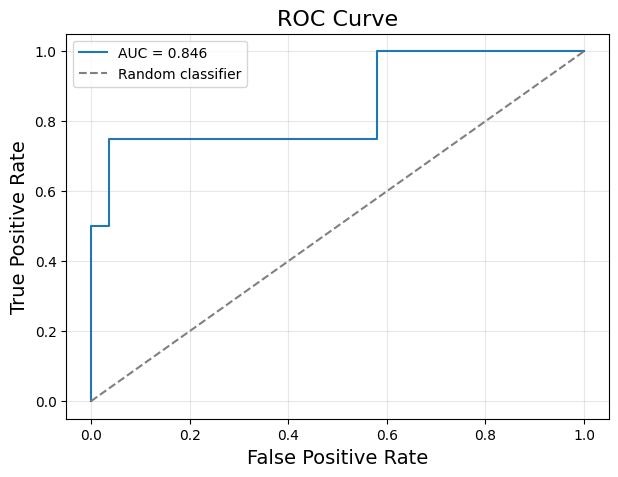

threshold=inf, FPR=0.00, TPR=0.00
threshold=0.81, FPR=0.00, TPR=0.25
threshold=0.70, FPR=0.00, TPR=0.50
threshold=0.40, FPR=0.04, TPR=0.50
threshold=0.39, FPR=0.04, TPR=0.75
threshold=0.12, FPR=0.58, TPR=0.75
threshold=0.12, FPR=0.58, TPR=1.00
threshold=0.00, FPR=1.00, TPR=1.00


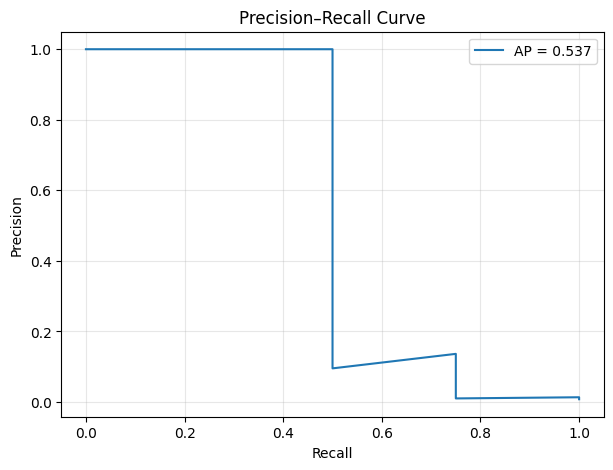

-------RESULTS USING THRESHOLD OF 0.7-------
Test recall: 0.5
Test precision: 1.0


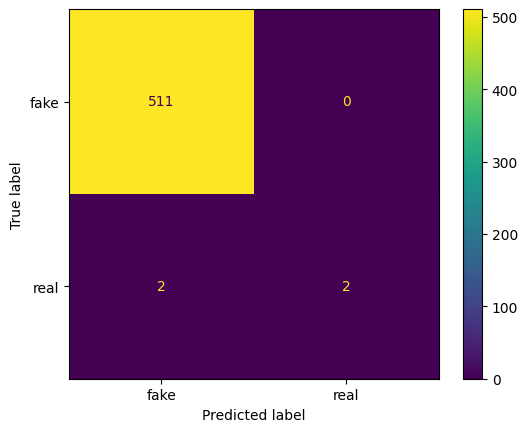

In [130]:
# Tuning of the threshold

# --- Results using threshold of 0.5 ---#

print('-------RESULTS USING THRESHOLD OF 0.5-------')

# Print the recall for the test set
print("Test recall:", recall_score(y_test, y_pred_test))

# Print the precision for the test set
print("Test precision:", precision_score(y_test, y_pred_test))

# Plot the AUC-ROC curve
fpr, tpr, thresholds = roc_curve(y_test, predicted_probabilities[:,1])

auc = roc_auc_score(y_test, predicted_probabilities[:,1])

plt.figure(figsize=(7,5), dpi=100)
plt.plot(fpr, tpr, label=f'AUC = {auc:.3f}')
plt.plot([0,1], [0,1], '--', color='gray', label='Random classifier')

plt.xlabel('False Positive Rate', fontsize=14)
plt.ylabel('True Positive Rate', fontsize=14)
plt.title('ROC Curve', fontsize=16)
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()

for f, t, th in zip(fpr, tpr, thresholds):
    print(f"threshold={th:.2f}, FPR={f:.2f}, TPR={t:.2f}")

# Plot the Precison-Recall Curve
precision, recall, thresholds = precision_recall_curve(y_test, predicted_probabilities[:,1])
ap = average_precision_score(y_test, predicted_probabilities[:,1])

plt.figure(figsize=(7,5), dpi=100)
plt.plot(recall, precision, label=f'AP = {ap:.3f}')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision–Recall Curve')
plt.grid(True, alpha=0.3)
plt.legend()
plt.show()

# --- Results using threshold of 0.7 ---#

print('-------RESULTS USING THRESHOLD OF 0.7-------')

# Print the recall for the test set
print("Test recall:", recall_score(y_test, y_pred_test_2))

# Print the precision for the test set
print("Test precision:", precision_score(y_test, y_pred_test_2))


fpr, tpr, thresholds = roc_curve(y_test, predicted_probabilities[:,1])


# Plot the confusion matrix
cm = confusion_matrix(y_test, y_pred_test_2)
disp = ConfusionMatrixDisplay(cm, display_labels=['fake','real'])
disp.plot()



['51890.mp3', '52180.mp3', '53966.mp3', '54100.mp3']
<class 'numpy.ndarray'>
(2048, 4111)


/opt/miniconda3/envs/workspace1/lib/python3.8/site-packages/matplotlib/cbook/__init__.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


<class 'numpy.ndarray'>
(2048, 2615)
<class 'numpy.ndarray'>
(2048, 847)
<class 'numpy.ndarray'>
(2048, 890)


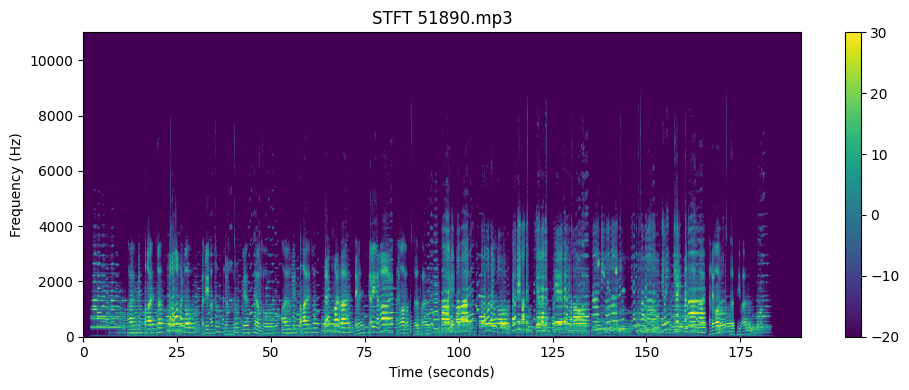

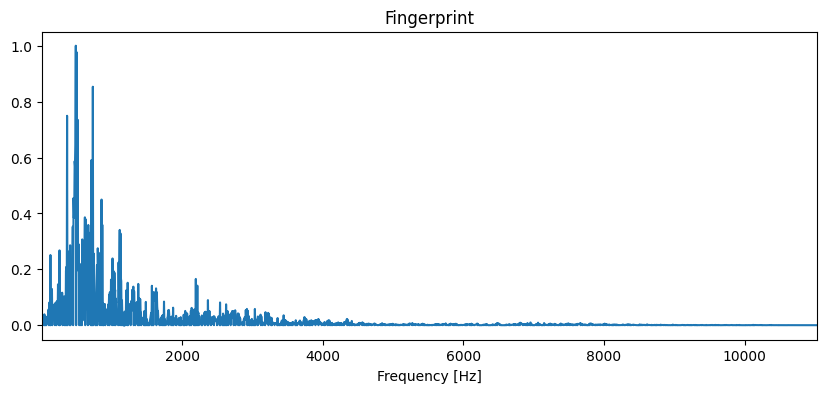

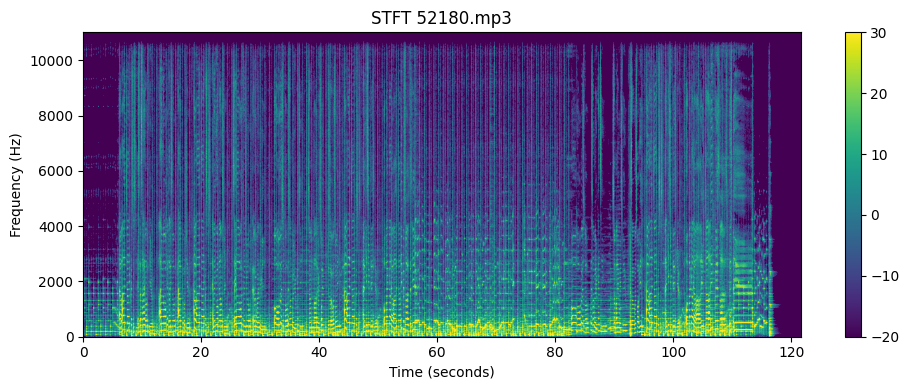

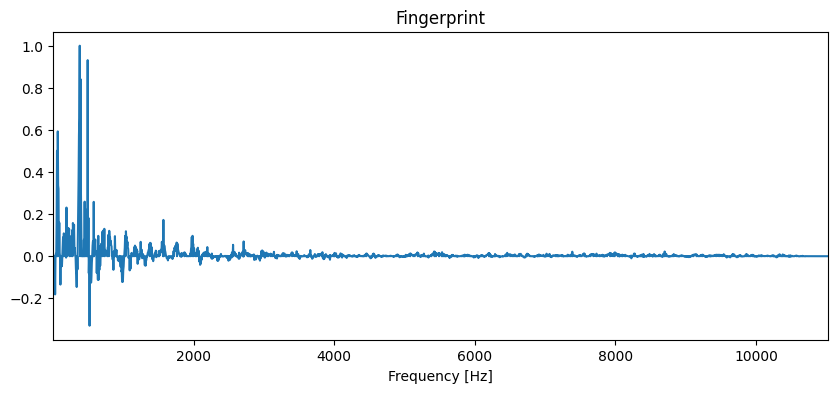

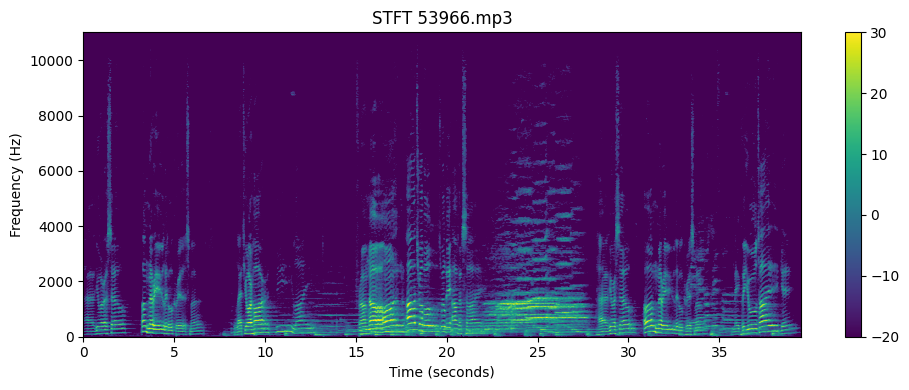

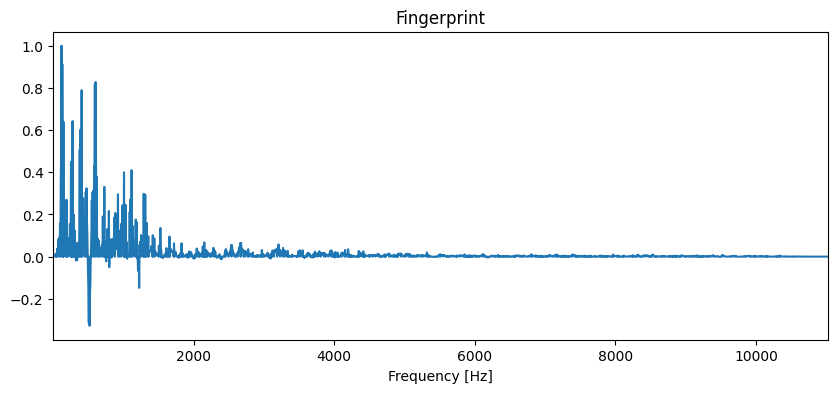

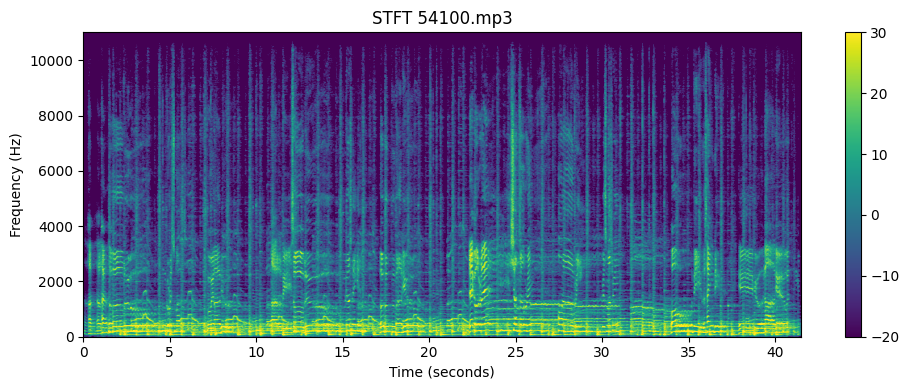

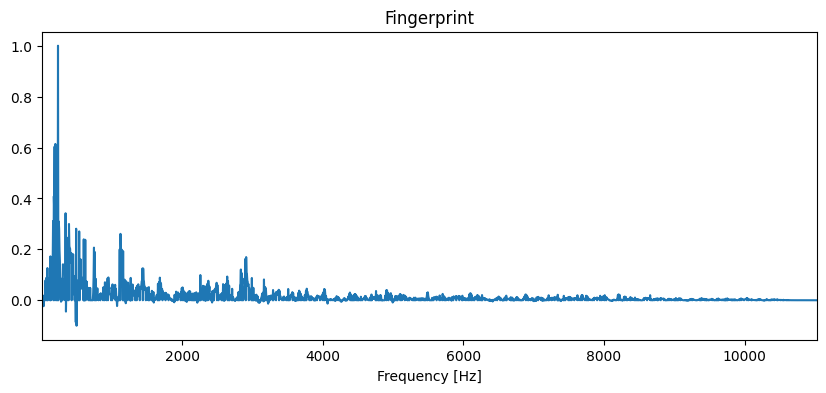

In [149]:
# False Negatives Analysis 

print(gt_real)

N=4096
H=1024
w = np.hanning(N)

for filename in gt_real:
    path = os.path.join('sonics/test', filename)
    file = librosa.load(path, sr = 22050)[0]
    F_stft, F_stft_dB = STFT(file, w, H, filename)

    f_vector, x_freq = compute_feature_vector(path, Fs)
    plt.figure(figsize=(10,4))
    plt.plot(x_freq, f_vector)
    plt.xlabel("Frequency [Hz]")
    plt.xlim((x_freq[0], x_freq[-1]))
    plt.title("Fingerprint")



## Question 5

In [37]:
# Find the key sentence
